# Poject title: Revolutionizing Bus Routes: A Data-Driven Approach

### Introduction:
- In bustling urban settings, balancing public safety and optimizing travel efficiency are essential for improving commuters' quality of life. Even the most effective public transport systems must navigate challenges like frequent accidents, safety concerns, and high congestion.
- This project tackles these issues by creating a model that proposes alternative bus routes, reducing exposure to high-risk areas to enhance both safety and travel efficiency.
- 
Using COVID-19 case data as a proxy for high-risk areas, this model is applied to Singapo's public bus system for demonstraton.
.


### Problem Statement:
With the continued presence of COVID-19 cases and significant passenger volumes at certain locations and times in Singapore, there is a challenge in adjusting bus routes to avoid high-risk areas. 

### Proposed Solution:
The proposed solution employs a dual approach to enhance bus route optimization. 
- First, `unsupervised machine learning` techniques are used to cluster Covid-19 high-risk areas.
- Second, a `supervised machine learning` model predicts passenger volume at specific locations and times.
- These models work together to suggest alternative bus routes that avoid areas with both COVID-19 clusters and high passenger volume, while minimizing travel distance.


### Datasets used
This project utilizes a total of 7 datasets from 4 different sources.
- `'Covid19CaseDetails.csv'` (https://beta.data.gov.sg/datasets/d_554627df56037a1296507f35c374f79d/view/): Singapore covid-19 cases details.
- `'transport_node_train_202308.csv'`, `'transport_node_train_202309.csv'`, `'transport_node_train_202310.csv'` (https://www.kaggle.com/datasets/yorkyong/singapore-passenger-volume-by-train-stations/): Singapore passenger volume by train stations.
- `'MRT Stations.csv'` (https://www.kaggle.com/datasets/shengjunlim/singapore-mrt-lrt-stations-with-coordinates/): List of MRT& LRT stations in Singapore with geographic coordinates in decimal degrees.
- `'bus_routes.csv'` (https://www.kaggle.com/datasets/gowthamvarma/singapore-bus-data-land-transport-authority/): Singapore public bus routes details.
- `'bus_stops.csv'` (https://www.kaggle.com/datasets/gowthamvarma/singapore-bus-data-land-transport-authority/): List of bus stops in Singapore with geographic coordinates in decimal degrees.




# 1. Import libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import time
from datetime import datetime
import requests

In [2]:
from geopy.geocoders import Nominatim
from geopy.exc import GeocoderTimedOut, GeocoderUnavailable

In [3]:
import tkinter as tk
from tkinter import ttk, messagebox

In [4]:
import folium
from folium.plugins import HeatMap

In [5]:
import os
os.environ['OMP_NUM_THREADS'] = '1'   # To avoid UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. 

In [6]:
from sklearn.preprocessing import OneHotEncoder, StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
from sklearn.neighbors import NearestNeighbors
from sklearn.linear_model import LinearRegression, Lasso
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import mean_squared_error, r2_score

In [7]:
from scipy.spatial import ConvexHull, QhullError
from scipy.interpolate import Rbf

In [8]:
from matplotlib.path import Path

In [9]:
import branca.colormap as cm

In [10]:
from itertools import permutations

# 2. Load datasets

#### Datasets from Kaggle

In [11]:
#!pip install kaggle

In [12]:
# Import the kaggle API library
from kaggle.api.kaggle_api_extended import KaggleApi

# Initialize Kaggle API
api = KaggleApi()

# Authenticate with my Kaggle credentials
api.authenticate()

In [13]:
# Download and unzip the dataset
dataset_paths = [
    'gowthamvarma/singapore-bus-data-land-transport-authority',
    'shengjunlim/singapore-mrt-lrt-stations-with-coordinates',
    'yorkyong/singapore-passenger-volume-by-train-stations', 
]

download_dir = 'downloaded dataset'

for path in dataset_paths:
    api.dataset_download_files(path, path = download_dir, unzip=True)

Dataset URL: https://www.kaggle.com/datasets/gowthamvarma/singapore-bus-data-land-transport-authority
Dataset URL: https://www.kaggle.com/datasets/shengjunlim/singapore-mrt-lrt-stations-with-coordinates
Dataset URL: https://www.kaggle.com/datasets/yorkyong/singapore-passenger-volume-by-train-stations


In [14]:
# Iterate through the directory and print the structure
for root, dirs, files in os.walk(download_dir):
    for file in files:
        print(os.path.join(root, file))

downloaded dataset\bus_routes.csv
downloaded dataset\bus_services.csv
downloaded dataset\bus_stops.csv
downloaded dataset\MRT Stations.csv
downloaded dataset\singapore-bus-data-land-transport-authority.zip
downloaded dataset\singapore-mrt-lrt-stations-with-coordinates.zip
downloaded dataset\singapore-passenger-volume-by-train-stations.zip
downloaded dataset\Train Station Codes and Chinese Names.xls
downloaded dataset\transport_node_train_202308.csv
downloaded dataset\transport_node_train_202309.csv
downloaded dataset\transport_node_train_202310.csv


In [15]:
bus_routes_df = pd.read_csv('dataset\\bus_routes.csv')
bus_stops_df = pd.read_csv('dataset\\bus_stops.csv')
train_stn_df = pd.read_csv('dataset\MRT Stations.csv')
train_aug_df = pd.read_csv('dataset\\transport_node_train_202308.csv')
train_sep_df = pd.read_csv('dataset\\transport_node_train_202309.csv')
train_oct_df = pd.read_csv('dataset\\transport_node_train_202310.csv')

#### Dataset from Data.gov.sg

In [16]:
# URL for the Data.gov.sg API
base_url = "https://data.gov.sg/api/action/datastore_search"
url = base_url + "?resource_id=d_554627df56037a1296507f35c374f79d"

# Send a GET request to the API
response = requests.get(url)

# Check if the request was successful
if response.status_code == 200:
    # Convert JSON response directly to pandas DataFrame
    covid_df = pd.DataFrame(response.json()['result']['records'])
    print("\'covid_df\' dataframe created.")
else:
    print(f"Failed to download dataset. Status code: {response.status_code}")

'covid_df' dataframe created.


# 3. Data Preparation

#### 3.1. `covid_df` dataframe
This dataframe will be utilized for clustering Covid-19 cases.

In [17]:
# Inspect dataframe
covid_df.head()

,_id,case_id,age,gender,nationality,imported_local,place,public_healthcare_institution,status,date_of_confirmation,date_of_discharge,places_visited,residing_location,residing_postal_code,reference_url
0,1,Case 1,66,M,Chinese,Imported,Wuhan,Singapore General Hospital,Hospitalised,1/23/2020,-,N/A,Shangri-La Rasa Sentosa Resort & Spa,98970,https://www.moh.gov.sg/news-highlights/details...
1,2,Case 2,53,F,Chinese,Imported,Wuhan,National Centre for Infectious Disease,Discharged,1/24/2020,2/7/2020,"Raffles Hospital, Tan Tock Seng Emergency Depa...","J8 hotel, 8 Townshend Road",207606,https://www.moh.gov.sg/news-highlights/details...
2,3,Case 3,37,M,Chinese,Imported,Wuhan,Singapore General Hospital,Hospitalised,1/24/2020,-,N/A,N/A,0,https://www.moh.gov.sg/news-highlights/details...
3,4,Case 4,36,M,Chinese,Imported,Wuhan,Sengkang General Hospital,Discharged,1/25/2020,2/12/2020,"USS, Vivocity",Village Hotel Sentosa,99951,https://www.moh.gov.sg/news-highlights/details...
4,5,Case 5,56,F,Chinese,Imported,Wuhan,National Centre for Infectious Disease,Hospitalised,1/27/2020,-,Tan Tock Seng Hospital,Ceylon Road,429728,https://www.moh.gov.sg/news-highlights/details...


`'places_visited'` and `'residing_location'` will be used to extract their geographic coordinates, which will then serve as features for clustering models.

In [18]:
covid_df['places_visited'].value_counts()[:5]

places_visited
N/A                                                                                     18
Grace Assembly of God (Tanglin), Grace Assembly of God (Bukit Batok)                     4
Tan Tock Seng Hospital,The Life Church and Missions Singapore (146B Paya Lebar Road)     2
Yong Thai Hang                                                                           2
Grace Assembly of God (Tanglin) (355 Tanglin Road)                                       2
Name: count, dtype: int64

In [19]:
covid_df['residing_location'].value_counts()[:5]

residing_location
N/A                      15
Mei Hwan Drive            6
Jalan Bukit Merah         4
Lorong Lew Lian           2
Jurong West Street 64     2
Name: count, dtype: int64

In [20]:
covid_df['residing_postal_code'].value_counts()[:5]

residing_postal_code
0         44
159456     4
99951      2
531004     2
79333      2
Name: count, dtype: int64

In [21]:
n = len(covid_df.loc[(covid_df['residing_postal_code'] == '0') & (covid_df['residing_location'] != 'N/A'), :])
print(f"There are {n} observations where the 'residing_location' is non-null, but the corresponding postal code is not recorded.")

There are 30 observations where the 'residing_location' is non-null, but the corresponding postal code is not recorded.


- Since there are more missing values in the postal codes, we will omit this column and use 'residing_location' instead.
- Next, we will extract the geographic coordinates for `'places_visited'` and `'residing_location'`.

In [22]:
geolocator = Nominatim(user_agent = "my_app")

In [23]:
# Define a function that takes in an address as input and returns its latitude & longitude

def geocode_address(address, max_retries=5):
    retries = 0
    while retries < max_retries:
        try:
            if address == 'N/A':
                return None, None
            location = geolocator.geocode(address, timeout=10)
            if location:
                return location.latitude, location.longitude
            else:
                return None, None
            # while loop will exit once one of above condition is met. 
            # if a GeocoderTimedOut or GeocoderUnavailable exception is raised during the geocoding attempt, it is caught by the except block. This doesn't mean satisfying 'else' condition.
            # the else condition handles cases where geocoding succeeds but does not return a result (location is None).
        
        except (GeocoderTimedOut, GeocoderUnavailable):
            print(f"Geocoding request timed out or service unavailable for address: {address}. Retrying...")
            retries += 1
    print(f"Failed to geocode address after {max_retries} retries for address: {address}")
    # printing above statement will not be executed if one of above condition is met, because the function has already returned.  
    return None, None

In [24]:
# Create empty lists to store coordinates of Covid-19 cases
covid_lat = []
covid_lon = []

In [25]:
%%time

# Extract latitudes & longitudes for 'places_visited'
for index, row in covid_df.iterrows():
    locations = [loc.strip() for loc in row['places_visited'].split(',')]
    for location in locations:
        lat, lon = geocode_address(location, max_retries = 3)
        covid_lat.append(lat)
        covid_lon.append(lon)

# Extract latitudes & longitudes for 'residing_location'
for index, row in covid_df.iterrows():
    locations = [loc.strip() for loc in row['residing_location'].split(',')]
    for location in locations:
        lat, lon = geocode_address(location, max_retries = 3)
        covid_lat.append(lat)
        covid_lon.append(lon)

CPU times: total: 234 ms
Wall time: 1min 43s


In [26]:
covid_lat = [x for x in covid_lat if x is not None]
covid_lon = [x for x in covid_lon if x is not None]

In [27]:
# convert into DataFrame
covid_coordinates = pd.DataFrame({'longitude': covid_lon, 'latitude': covid_lat})

In [28]:
# remove rows of coordinates outside Singapore

longitude_min = 103.36
longitude_max = 104.25
latitude_min = 1.09
latitude_max = 1.46

covid_coordinates = covid_coordinates[(covid_coordinates['longitude'] >= longitude_min) &
                                      (covid_coordinates['longitude'] <= longitude_max) &
                                      (covid_coordinates['latitude'] >= latitude_min) &
                                      (covid_coordinates['latitude'] <= latitude_max)]

#### 3.2. `train_aug_df`, `train_sep_df`, `train_oct_df`, and `train_stn_df` dataframes
Data preparation involves merging these dataframes, performing feature engineering, and creating a final dataframe for use in supervised regression machine learning models.

In [29]:
train_volume_df = pd.concat([train_aug_df, train_sep_df, train_oct_df], ignore_index=True)

In [30]:
# Inspect dataframe
train_volume_df.head()

,YEAR_MONTH,DAY_TYPE,TIME_PER_HOUR,PT_TYPE,PT_CODE,TOTAL_TAP_IN_VOLUME,TOTAL_TAP_OUT_VOLUME
0,2023-08,WEEKDAY,22,TRAIN,NS28,752,311
1,2023-08,WEEKENDS/HOLIDAY,22,TRAIN,NS28,612,223
2,2023-08,WEEKENDS/HOLIDAY,0,TRAIN,DT10/TE11,37,242
3,2023-08,WEEKDAY,0,TRAIN,DT10/TE11,86,445
4,2023-08,WEEKDAY,10,TRAIN,EW16/NE3/TE17,28179,39454


In [31]:
# Merge two datasets
train_merged_df = pd.merge(train_volume_df, train_stn_df, left_on='PT_CODE', right_on='STN_NO')

# Drop duplicate and unecessary columns
train_merged_df.drop(columns=['PT_TYPE', 'Unnamed: 0', 'OBJECTID', 'STN_NO', 'geometry'], inplace=True)

# Reset index
train_merged_df.reset_index(drop=True, inplace=True)

In [32]:
# Inspect merged df
train_merged_df.head()

,YEAR_MONTH,DAY_TYPE,TIME_PER_HOUR,PT_CODE,TOTAL_TAP_IN_VOLUME,TOTAL_TAP_OUT_VOLUME,STN_NAME,Latitude,Longitude
0,2023-08,WEEKDAY,22,NS28,752,311,MARINA SOUTH PIER MRT STATION,1.271337,103.86286
1,2023-08,WEEKENDS/HOLIDAY,22,NS28,612,223,MARINA SOUTH PIER MRT STATION,1.271337,103.86286
2,2023-08,WEEKDAY,8,NS28,1183,2955,MARINA SOUTH PIER MRT STATION,1.271337,103.86286
3,2023-08,WEEKENDS/HOLIDAY,8,NS28,332,1815,MARINA SOUTH PIER MRT STATION,1.271337,103.86286
4,2023-08,WEEKENDS/HOLIDAY,7,NS28,214,874,MARINA SOUTH PIER MRT STATION,1.271337,103.86286


#### 3.2.1 Feature engineering

In [33]:
# One-hot encode 'DAY_TYPE'
encoder = OneHotEncoder(sparse_output=False, drop='first')    # drop='first' to avoid multicollinearity
train_merged_df['day_encoded'] = encoder.fit_transform(train_merged_df[['DAY_TYPE']])

In [34]:
train_merged_df.head()

,YEAR_MONTH,DAY_TYPE,TIME_PER_HOUR,PT_CODE,TOTAL_TAP_IN_VOLUME,TOTAL_TAP_OUT_VOLUME,STN_NAME,Latitude,Longitude,day_encoded
0,2023-08,WEEKDAY,22,NS28,752,311,MARINA SOUTH PIER MRT STATION,1.271337,103.86286,0.0
1,2023-08,WEEKENDS/HOLIDAY,22,NS28,612,223,MARINA SOUTH PIER MRT STATION,1.271337,103.86286,1.0
2,2023-08,WEEKDAY,8,NS28,1183,2955,MARINA SOUTH PIER MRT STATION,1.271337,103.86286,0.0
3,2023-08,WEEKENDS/HOLIDAY,8,NS28,332,1815,MARINA SOUTH PIER MRT STATION,1.271337,103.86286,1.0
4,2023-08,WEEKENDS/HOLIDAY,7,NS28,214,874,MARINA SOUTH PIER MRT STATION,1.271337,103.86286,1.0


#### 3.3. `bus_routes_df` and `bus_stops_df` dataframes
Data preparation steps to create a dataframe suitable for generating bus routes.

In [35]:
# Inspect dataframe
bus_routes_df.head()

,Unnamed: 0,ServiceNo,Operator,Direction,StopSequence,BusStopCode,Distance,WD_FirstBus,WD_LastBus,SAT_FirstBus,SAT_LastBus,SUN_FirstBus,SUN_LastBus
0,0,10,SBST,1,1,75009,0.0,0500,2300,0500,2300,0500,2300
1,1,10,SBST,1,2,76059,0.6,0502,2302,0502,2302,0502,2302
2,2,10,SBST,1,3,76069,1.1,0504,2304,0504,2304,0503,2304
3,3,10,SBST,1,4,96289,2.3,0508,2308,0508,2309,0507,2308
4,4,10,SBST,1,5,96109,2.7,0509,2310,0509,2311,0508,2309


In [36]:
bus_routes_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26317 entries, 0 to 26316
Data columns (total 13 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Unnamed: 0    26317 non-null  int64  
 1   ServiceNo     26317 non-null  object 
 2   Operator      26317 non-null  object 
 3   Direction     26317 non-null  int64  
 4   StopSequence  26317 non-null  int64  
 5   BusStopCode   26317 non-null  object 
 6   Distance      26312 non-null  float64
 7   WD_FirstBus   26317 non-null  object 
 8   WD_LastBus    26317 non-null  object 
 9   SAT_FirstBus  26317 non-null  object 
 10  SAT_LastBus   26317 non-null  object 
 11  SUN_FirstBus  26317 non-null  object 
 12  SUN_LastBus   26317 non-null  object 
dtypes: float64(1), int64(3), object(9)
memory usage: 2.6+ MB


In [37]:
# Inspect dataframe
bus_stops_df.head()

,Unnamed: 0,BusStopCode,RoadName,Description,Latitude,Longitude
0,0,481,Woodlands Rd,BT PANJANG TEMP BUS PK,1.383764,103.758300
1,1,1012,Victoria St,Hotel Grand Pacific,1.296848,103.852536
2,2,1013,Victoria St,St. Joseph's Ch,1.297710,103.853225
3,3,1019,Victoria St,Bras Basah Cplx,1.296990,103.853022
4,4,1029,Nth Bridge Rd,Cosmic Insurance Bldg,1.296673,103.854414


In [38]:
bus_stops_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5021 entries, 0 to 5020
Data columns (total 6 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Unnamed: 0   5021 non-null   int64  
 1   BusStopCode  5021 non-null   int64  
 2   RoadName     5021 non-null   object 
 3   Description  5021 non-null   object 
 4   Latitude     5021 non-null   float64
 5   Longitude    5021 non-null   float64
dtypes: float64(2), int64(2), object(2)
memory usage: 235.5+ KB


In [39]:
# Convert 'BusStopCode' to string, before merging the two dataframes
bus_routes_df['BusStopCode'] = bus_routes_df['BusStopCode'].astype(str)
bus_stops_df['BusStopCode'] = bus_stops_df['BusStopCode'].astype(str)
bus_df = pd.merge(bus_routes_df, bus_stops_df, on='BusStopCode', how='left')

In [40]:
# Concatenate 'ServiceNo' and 'Direction' as there are two directions for each bus service no.
bus_df['bus_id'] = bus_df['ServiceNo'].astype(str) + '_' + bus_df['Direction'].astype(str)

In [41]:
bus_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26317 entries, 0 to 26316
Data columns (total 19 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Unnamed: 0_x  26317 non-null  int64  
 1   ServiceNo     26317 non-null  object 
 2   Operator      26317 non-null  object 
 3   Direction     26317 non-null  int64  
 4   StopSequence  26317 non-null  int64  
 5   BusStopCode   26317 non-null  object 
 6   Distance      26312 non-null  float64
 7   WD_FirstBus   26317 non-null  object 
 8   WD_LastBus    26317 non-null  object 
 9   SAT_FirstBus  26317 non-null  object 
 10  SAT_LastBus   26317 non-null  object 
 11  SUN_FirstBus  26317 non-null  object 
 12  SUN_LastBus   26317 non-null  object 
 13  Unnamed: 0_y  23708 non-null  float64
 14  RoadName      23708 non-null  object 
 15  Description   23708 non-null  object 
 16  Latitude      23708 non-null  float64
 17  Longitude     23708 non-null  float64
 18  bus_id        26317 non-nu

In [42]:
# There are BusStopCode with null Latitude & longitude values. All rows involving corresponding bus_id will be removed to ensure the accuracy of the bus information provided.
bus_ids_with_nan = bus_df[bus_df['Latitude'].isna()]['bus_id'].unique()
bus_df = bus_df[~bus_df['bus_id'].isin(bus_ids_with_nan)]

In [43]:
# Calculate distance of individual stops.
# diff(): Computes the difference between each row and the previous row within each group
bus_df['distance'] = bus_df.groupby('bus_id')['Distance'].diff().fillna(0)

In [44]:
# Drop unnecessary columns
bus_df = bus_df.drop(columns = ['Unnamed: 0_x', 'Operator', 'Distance', 'WD_FirstBus', 'WD_LastBus', 'SAT_FirstBus', 'SAT_LastBus', 'SUN_FirstBus', 'SUN_LastBus', 'Unnamed: 0_y'])

In [45]:
bus_df.head()

,ServiceNo,Direction,StopSequence,BusStopCode,RoadName,Description,Latitude,Longitude,bus_id,distance
257,100A,1,1,66009,S'goon Ave 2,S'Goon Int,1.350466,103.871690,100A_1,0.0
258,100A,1,2,62129,Upp S'goon Rd,Blk 403,1.346990,103.872055,100A_1,0.6
259,100A,1,3,62119,Upp S'goon Rd,Aft Sunshine Lodge,1.344833,103.871092,100A_1,0.3
260,100A,1,4,61049,Upp S'goon Rd,Aft Bartley Rd,1.341963,103.870969,100A_1,0.3
261,100A,1,5,61039,Upp S'goon Rd,Woodleigh Stn Exit A,1.338453,103.870849,100A_1,0.4


# 4. Setting Up User Input Prompts
A message box that enables the user to input the following information: Day, Time of Day, and the names of the starting and ending bus stops.

In [46]:
def on_select(event=None):
    # Check if all selections are made and enable the button if true
    global selected_day, selected_time, selected_start, selected_end
    selected_day = day_combobox.get()
    selected_time = time_combobox.get()
    selected_start = start_combobox.get()
    selected_end = end_combobox.get()

    # Update button state based on selection
    if selected_day and selected_time and selected_start and selected_end:
        submit_button.config(state=tk.NORMAL)
    else:
        submit_button.config(state=tk.DISABLED)

In [47]:
def submit_and_close():
    on_select()  # Ensure selections are updated
    messagebox.showinfo("Selections", f"Day: {selected_day}\nTime(hr): {selected_time}\nStart point: {selected_start}\nEnd point: {selected_end}")
    root.destroy()

In [48]:
def center_window(window, width, height):         # window refers to Tkinter root window
    screen_width = window.winfo_screenwidth()     # screen_width refers to width of the entire screen on which root window will be displayed.
    screen_height = window.winfo_screenheight()
    x = (screen_width // 2) - (width // 2)
    y = (screen_height // 2) - (height // 2)
    window.geometry(f'{width}x{height}+{x}+{y}')  # This sets the size of Tkinter root window and its position on the screen

In [49]:
# Initialize Tkinter root window
root = tk.Tk()
root.title("Generate best routes:")
root.configure(bg="#f0f0f0")  # Light gray background

In [50]:
# Define options for comboboxes
day_selection = sorted(train_merged_df['DAY_TYPE'].unique())
day_selection.insert(0, 'Now')
time_selection = list(np.arange(0, 24))
time_selection.insert(0, 'Now')
stops_selection = sorted(bus_df['Description'].unique())

In [51]:
# Create labels and comboboxes
tk.Label(root, text="Day:").pack(padx=10, pady=5, anchor='w')
day_combobox = ttk.Combobox(root, values=day_selection)
day_combobox.pack(padx=10, pady=5, fill='x')
day_combobox.bind("<<ComboboxSelected>>", on_select)

tk.Label(root, text="Time(hr):").pack(padx=10, pady=5, anchor='w')
time_combobox = ttk.Combobox(root, values=time_selection)
time_combobox.pack(padx=10, pady=5, fill='x')
time_combobox.bind("<<ComboboxSelected>>", on_select)

tk.Label(root, text="Start point:").pack(padx=10, pady=5, anchor='w')
start_combobox = ttk.Combobox(root, values=stops_selection)
start_combobox.pack(padx=10, pady=5, fill='x')
start_combobox.bind("<<ComboboxSelected>>", on_select)

tk.Label(root, text="End point:").pack(padx=10, pady=5, anchor='w')
end_combobox = ttk.Combobox(root, values=stops_selection)
end_combobox.pack(padx=10, pady=5, fill='x')
end_combobox.bind("<<ComboboxSelected>>", on_select)

# Submit button to close the window
submit_button = tk.Button(root, text="Submit and Close", command=submit_and_close, state=tk.DISABLED)
submit_button.pack(pady=20, fill='x', padx=10)

# Center the window
center_window(root, 300, 320)

# Start the Tkinter event loop
root.mainloop()

In [52]:
if selected_day == 'Now':
    now = datetime.now()
    # weekday() returns 0 for Monday and 6 for Sunday
    if now.weekday() < 5:
        selected_day = 0  #'WEEKDAY' is encoded as 0
    else:
        selected_day = 1  #'WEEKENDS/HOLIDAY' is encoded as 1
elif selected_day == 'WEEKDAY':
    selected_day = 0
else:
    selected_day = 1

In [53]:
if selected_time == 'Now':
    now = datetime.now()
    # Extract the hour in 24-hour format
    selected_time = int(now.strftime('%H'))
else:
    selected_time = int(selected_time)

In [54]:
# create dictionaries that map location description to BusStopCode
desc_stopcode = dict(zip(bus_df['Description'], bus_df['BusStopCode']))

selected_start = desc_stopcode[selected_start]
selected_end = desc_stopcode[selected_end]

# 5.1. [Modelling] Clustering Covid-19 cases
Three unsupervised machine learning models are employed to cluster COVID-19 cases by locations in Singapore.

#### KMeans Clustering

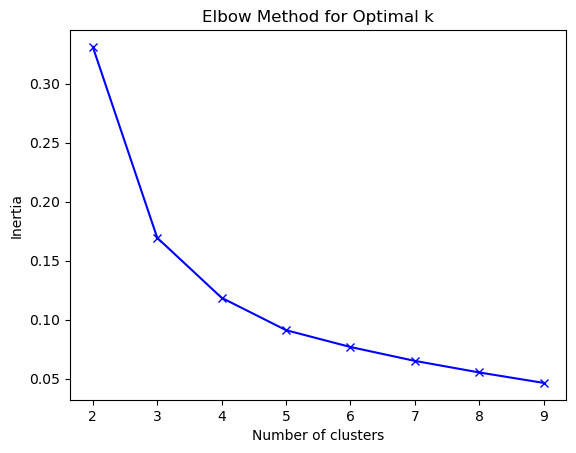

In [55]:
# Elbow Method to find optimal n_clusters for KMeans

inertia = []
k_range = range(2, 10, 1)

for k in k_range:
    kmeans = KMeans(n_clusters=k, n_init=10)
    kmeans.fit(covid_coordinates)
    inertia.append(kmeans.inertia_)

plt.plot(k_range, inertia, 'bx-')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.title('Elbow Method for Optimal k')
plt.show()

In [56]:
# optimal n_cluster is set based on elbow method
n_clusters = 4
kmeans = KMeans(n_clusters=n_clusters, n_init=10)
kmeans.fit(covid_coordinates)

KMeans(n_clusters=4, n_init=10)

In [57]:
# define function to visualize geospatial data

def geospatial_visualization(longitude, latitude, cluster_labels):
    """
    longitude = pandas series or list of longitude
    latitude = pandas series or list of latitude
    cluster_labels = pandas series or list of cluster labels
    """
    
    # Center map around the mean longitude and latitude
    mean_longitude = longitude.mean()
    mean_latitude = latitude.mean()
    
    # Create a map centered around the mean coordinates
    cluster_map = folium.Map(
        location=[mean_latitude, mean_longitude],
        zoom_start=12,
        control_scale=True,
        tiles='https://{s}.basemaps.cartocdn.com/light_all/{z}/{x}/{y}{r}.png',   # This parameter specifies the URL template for the tile layer. In this case, we're using CartoDB’s light all tile layer, which is grayscale.
        attr='CartoDB'
    )
    
    # Define colors for clusters
    cluster_colors = ['blue', 'green', 'red', '#9370db', 'orange', 'gray', 'indigo', 'maroon', '#4682B4', '#F08080', 'pink', 'turquoise', 'gold']
    
    # Add markers
    for lon, lat, cluster in zip(longitude, latitude, cluster_labels):
        folium.CircleMarker(
            [lat, lon],
            radius=4,
            color=cluster_colors[cluster],
            fill=True,
            fill_color=cluster_colors[cluster],
            fill_opacity=0.7,
            popup=f'Cluster {cluster}'  # Popup text on click
        ).add_to(cluster_map)
    
    # Display the map
    return cluster_map

In [58]:
# KMeans clustering
geospatial_visualization(covid_coordinates['longitude'], covid_coordinates['latitude'], kmeans.labels_)

#### DBSCAN Clustering

In [59]:
# define function to generate k-distance graph

def k_distance(df):
    """ df = Dataframe consisting of x & y coordinates """
    
    neighbors = NearestNeighbors(n_neighbors=2)
    neighbors_fit = neighbors.fit(df)
    distances, indices = neighbors_fit.kneighbors(df)
    distances_with_indices = list(enumerate(distances[:, 1]))
    distances_with_indices.sort(key = lambda x: x[1])
    
    plt.plot([x[1] for x in distances_with_indices])
    plt.title('k-Distance Graph')
    plt.xlabel('Points')
    plt.ylabel('Distance')
    plt.grid()
    plt.show()

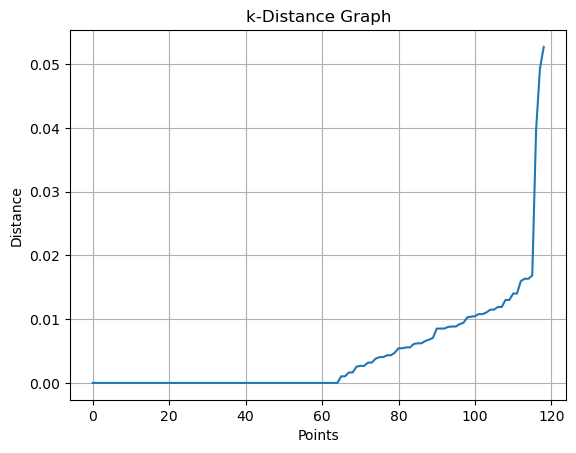

In [60]:
# generate k-distance graph
k_distance(covid_coordinates)

In [61]:
# initiate DBSCAN model
# k-distance graph used to decide epsilon

minPoints = 2
epsilon = 0.02
dbscan = DBSCAN(eps=epsilon, min_samples=minPoints)

# fit the model
dbscan.fit(covid_coordinates)

# get the labels
dbscan_labels = dbscan.labels_

In [62]:
# DBSCAN Clustering
geospatial_visualization(covid_coordinates['longitude'], covid_coordinates['latitude'], dbscan_labels)

#### Hierarchical Clustering (Agglomerative Clustering)

In [63]:
# Initiate Agglomerative Clustering model
n_clusters = 10
agg_clustering = AgglomerativeClustering(n_clusters = n_clusters)

# fit the model
agg_clustering.fit(covid_coordinates)

# get the labels
agg_labels = agg_clustering.labels_

In [64]:
# Hierarchical Clustering
geospatial_visualization(covid_coordinates['longitude'], covid_coordinates['latitude'], agg_labels)

Among KMeans, DBSCAN, and hierarchical clustering, `DBSCAN` is selected as the best model for clustering COVID case locations due to its ability to define clusters with the highest density of points.

#### Defining clusters' borders
- This is necessary to determine whether the coordinates of a specific bus stop fall within the defined COVID clusters.
- The Convex Hull is used to define the borders of clusters. It provides the smallest convex boundary that encloses all the points within a given cluster.

In [65]:
# Define a set of cluster colors
cluster_colors = ['blue', 'green', 'red', '#9370db', 'orange', 'gray', 'indigo', 'maroon', '#4682B4', '#F08080', '#FF6347', '#40E0D0']

In [66]:
# Initialize Folium map
mean_longitude = covid_coordinates['longitude'].mean()
mean_latitude = covid_coordinates['latitude'].mean()
map = folium.Map(
    location=[mean_latitude, mean_longitude],
    zoom_start=12,
    tiles='https://{s}.basemaps.cartocdn.com/light_all/{z}/{x}/{y}{r}.png',   # This parameter specifies the URL template for the tile layer. In this case, we're using CartoDB’s light all tile layer, which is grayscale.
    attr='CartoDB'
)

In [67]:
# Dictionary to store coordinates of hull vertices.
hulls = {}

# Iterate over unique cluster labels
for i, label in enumerate(set(dbscan_labels)):
    
    if label == -1:  # Skip noise points
        continue
        
    # Get points for the current cluster
    points = covid_coordinates[dbscan_labels == label].values
    
    # Check if there are enough points to compute a convex hull
    if len(points) >= 3:
        try:
            hull = ConvexHull(points)
            
            # Convert convex hull vertices to a list of tuples for Folium in (lat, lon) form
            # 'hull.vertices' returns the indices of polygon vertices            
            hull_points = [(points[vertex, 1], points[vertex, 0]) for vertex in hull.vertices]
            hulls[label] = hull_points
            hull_points.append(hull_points[0])  # Close the polygon for plotting purpose
            
            # Create a Folium polygon and add it to the map            
            folium.Polygon(
                locations=hull_points,
                color=cluster_colors[i % len(cluster_colors)],
                fill=True,
                fill_color=cluster_colors[i % len(cluster_colors)],
                fill_opacity=0.2,
                popup=f'Cluster {label}' # Popup text on click
            ).add_to(map)
        
        except QhullError as e:
            print(f"ConvexHull error for cluster {label}:\n{e}")
    else:
        print(f"Cluster {label} has fewer than 3 points and cannot compute convex hull.")
        hulls[label] = points

    # Add markers
    for lon, lat in points:
        folium.CircleMarker(
            location=[lat, lon],
            radius=4,
            color=cluster_colors[i % len(cluster_colors)],
            fill=True,
            fill_color=cluster_colors[i % len(cluster_colors)],
            fill_opacity=0.7
        ).add_to(map)

Cluster 4 has fewer than 3 points and cannot compute convex hull.
Cluster 6 has fewer than 3 points and cannot compute convex hull.


In [68]:
# Display map
map

In [69]:
def stops_in_cluster(row):
    """
    Parameters (row): dataframe row
    Returns a boolean array indicating whether each coordinate point (bus stop) falls within any of the defined convex hulls (e.g., covid cluster areas) for a given route. 
    
    This function will be used later when generating best routes.
    """
    
    points = np.array(row['coordinates'])

    final_array= np.zeros(len(points), dtype=bool)

    for label, hull_points in hulls.items():
        # create a Path object for the convex hull
        path = Path(hull_points)

        # Get boolean array for current convex hull
        boolean_array = path.contains_points(points)

        final_array |= boolean_array

    return final_array

# 5.2. [Modelling] Passengers volume prediction
To predict passenger volume at specific locations and times, supervised machine learning models are trained on four features: 'Day', 'Time of day', 'Latitude', and 'Longitude'.


#### Train & test data split

In [70]:
# Define features and response variable
X = train_merged_df[['TIME_PER_HOUR', 'Latitude', 'Longitude', 'day_encoded']]
y = train_merged_df['TOTAL_TAP_IN_VOLUME'] + train_merged_df['TOTAL_TAP_OUT_VOLUME']

In [71]:
# Splitting data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#### Features scalling
- Linear Models (e.g., Linear Regression) benefit from scaling because features with larger ranges can dominate the objective function and affect the model's coefficients.
- Distance-Based Algorithms (e.g., K-Nearest Neighbors, SVMs) rely on distances between data points, so scaling ensures that no single feature disproportionately affects the distance calculations.
- Neural Networks perform better when input features are scaled, as it helps in faster convergence during training.
- While tree-based models like Decision Trees and Random Forests do not require scaling, `it doesn't harm to standardize the data`, ensuring a consistent preprocessing approach across different models.

In [72]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

#### Define, train, & evaluate models

In [73]:
# Perform grid search on neural network model for optimal hyperparameters, in order to avoid convergence error when performing model.fit()
# param_grid = {
#     'hidden_layer_sizes': [(100,), (100, 20), (100, 50), (100, 20, 10)],
#     'max_iter': [500, 800, 1000],
#     'learning_rate_init': [0.001, 0.01, 0.1]
# }

# NN = MLPRegressor()
# NN_grid_search = GridSearchCV(NN, param_grid, cv=5, n_jobs=-1, verbose=2)
# NN_grid_search.fit(X_train_scaled, y_train)

In [74]:
# print the best neural network model parameters and the best score
# print("Neural Network model:")
# print("- Best parameters found:", NN_grid_search.best_params_)
# print("- Best cross-validation score:", round(NN_grid_search.best_score_, 3))

In [75]:
# define models
models = {
    'Linear Regression': LinearRegression(),
    'Lasso Regression': Lasso(),
    'Decision Tree': DecisionTreeRegressor(),
    'Random Forest': RandomForestRegressor(),
    'Gradient Boosting': GradientBoostingRegressor(),
    'KNN': KNeighborsRegressor(),
    'Neural Network': MLPRegressor(hidden_layer_sizes=(100,50), max_iter=800, learning_rate_init=0.1)
}

In [76]:
%%time
results = []

# train & evaluate models
for name, model in models.items():
    
    start_time = time.time()
    model.fit(X_train_scaled, y_train)
    end_time = time.time()
    y_pred = model.predict(X_test_scaled)
    
    mse = mean_squared_error(y_test, y_pred)
    y_variance = np.var(y)                  # variance of response variable
    mse_to_variance = mse / y_variance      # ratio of model's prediction error to natural variability of data
    r2 = r2_score(y_test, y_pred)
    processing_time = end_time - start_time
    
    results.append({'MSE': f"{mse:.3e}", 'MSE to variance': round(mse_to_variance, 3), 'R2': round(r2, 3), 'Processing time (s)': round(processing_time, 3)})

CPU times: total: 11.7 s
Wall time: 20.1 s


In [77]:
models_summary = pd.DataFrame(results, index=list(models.keys()))
models_summary

,MSE,MSE to variance,R2,Processing time (s)
Linear Regression,1.078e+09,0.848,0.110,0.073
Lasso Regression,1.078e+09,0.848,0.110,0.005
Decision Tree,1.900e+07,0.015,0.984,0.020
Random Forest,2.105e+07,0.017,0.983,1.656
Gradient Boosting,4.830e+08,0.380,0.601,0.392
KNN,2.665e+08,0.210,0.780,0.006
Neural Network,4.627e+08,0.364,0.618,17.844


In [78]:
# slight adjustment to data to avoid overlapped bubble plots

min_distance = 0.05
offset = 0.01

adjusted_pos_x = []
adjusted_pos_y = []

for i, model in enumerate(models_summary.index):
    x = models_summary['R2'].iloc[i]
    y = models_summary['MSE to variance'].iloc[i]

    for j in range(len(adjusted_pos_x)):
        while abs(x - adjusted_pos_x[j]) < min_distance and abs(y - adjusted_pos_y[j]) < min_distance:
            y += offset

    adjusted_pos_x.append(x)
    adjusted_pos_y.append(y)

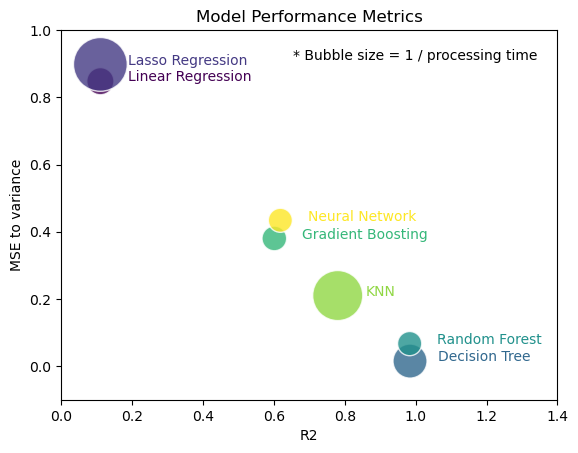

In [79]:
# bubble plot for visualization purpose

min_max_scaler = MinMaxScaler(feature_range=(1,5))
bubbles_size = min_max_scaler.fit_transform(1 / models_summary[['Processing time (s)']]) * 300
colors = plt.cm.viridis(np.linspace(0, 1, len(models_summary)))

plt.scatter(adjusted_pos_x, adjusted_pos_y, s=bubbles_size, c=colors, alpha=0.8, edgecolors='w')
plt.xlabel('R2')
plt.ylabel('MSE to variance')
plt.title('Model Performance Metrics')

# Create annotation objects with the same colors
for i, model in enumerate(models_summary.index):
    plt.annotate(model, (adjusted_pos_x[i], adjusted_pos_y[i]), color=colors[i], textcoords='offset points', xytext=(20,0), ha='left')

plt.text(0.96, 0.95, '* Bubble size = 1 / processing time', transform=plt.gca().transAxes, 
         fontsize=10, verticalalignment='top', horizontalalignment='right')

plt.xlim(0, 1.4)
plt.ylim(-0.1, 1.0)
plt.show()

#### Evaluate models' performances
Decision Tree is chosen as the best model for below reasons
- The MSE is significantly lower than data variance, indicating that the model's prediction errors are much smaller compared to the natural variability in the data.
- High r-square value suggests that the model explains the variability in the data extremely well.
- Low model processing time

Decision Trees work well here because they can handle both categorical and continuous features, capturing complex patterns and relationships that linear models might miss. This makes them better suited for predicting passenger volumes based on various factors like time and location.

In [80]:
dt = DecisionTreeRegressor()
dt.fit(X_train_scaled, y_train)

DecisionTreeRegressor()

In [81]:
# define a function that predicts passengers volume based on four features below. Single value for each feature.

def passengers_volume(day_encoded, time_in_hour, latitude, longitude):
    """
    Parameters:
    - day_encoded: '0' for weekday, '1' for weekend
    - time_in_hour: range of values from 0 to 23

    Returns:
    -  prediction of passenger volume
    """
    
    input_df = pd.DataFrame({
        'TIME_PER_HOUR': [time_in_hour], 
        'Latitude': [latitude],
        'Longitude': [longitude],
        'day_encoded': [day_encoded]
    })
    
    input_scaled = scaler.transform(input_df)
    prediction = dt.predict(input_scaled)

    return int(prediction[0])

In [82]:
volume_percentiles = (train_merged_df['TOTAL_TAP_IN_VOLUME'] + train_merged_df['TOTAL_TAP_OUT_VOLUME']).quantile([0.25, 0.50, 0.75])

def volume_category(volume):
    """
    Categorize passenger volume into 'high' or 'low'
    """
    if volume > volume_percentiles[0.75]:
        return 'high'
    else:
        return 'low'

In [83]:
def stops_passenger_vol(row, selected_day =selected_day, selected_time =selected_time):
    """
    Parameters:
    - row: dataframe row
    - selected_day: '0' for weekday, '1' for weekend
    - selected_time: range of values from 0 to 23

    Returns:
    - A list categorizing the passenger volume for each bus stop. 
    
    This function will be used later when generating best routes.
    """
    
    points = np.array(row['coordinates'])
    volumes = []
    
    # apply Decision Trees prediction model defined earlier
    volumes = [passengers_volume(selected_day, selected_time, point[0], point[1]) for point in points]

    # categorize volumes
    stops_volume = [volume_category(v) for v in volumes]
        
    return stops_volume

#### Visualization of passenger volume based on model predictions
This section is for visualization purposes only and can be commented out to improve model processing time.

In [84]:
# Example coordinates area
lat_min = 1.2400
lat_max = 1.4200
lon_min = 103.6700
lon_max = 104.0600

# Generate 1,000 random coordinates within the given latitude and longitude range
num_points = 1000
lat_random = np.random.uniform(lat_min, lat_max, num_points)
lon_random = np.random.uniform(lon_min, lon_max, num_points)
random_coords = np.column_stack((lat_random, lon_random))

In [85]:
# Stations with higher passengers volume. They will be included in heat map too for illustration purpose only.
popular_stn = ['JURONG EAST MRT STATION', 'RAFFLES PLACE MRT STATION', 'SERANGOON MRT STATION', 'NEWTON MRT STATION', 'TAMPINES MRT STATION', 'WOODLANDS MRT STATION']
popular_stn_coords = (train_merged_df.loc[train_merged_df['STN_NAME'].isin(popular_stn), ['Latitude', 'Longitude']]).drop_duplicates().values

# Append popular station coordinates to random coordinates
random_coords = np.vstack((random_coords, popular_stn_coords))

In [86]:
%%time
# Generate passenger volume data for the random coordinates
volumes = [passengers_volume(day_encoded =selected_day, time_in_hour =selected_time, latitude=lat, longitude=lon) for lat, lon in random_coords]

CPU times: total: 1.23 s
Wall time: 1.89 s


In [87]:
%%time
# Define grid step distance for interpolation
grid_step_distance = (lat_max - lat_min)/500
lat_grid, lon_grid = np.mgrid[lat_min: lat_max: grid_step_distance, lon_min: lon_max: grid_step_distance]
grid_points = np.column_stack([lat_grid.ravel(), lon_grid.ravel()])

# Use Rbf for spline-like interpolation
rbf = Rbf(np.array(random_coords)[:,0], np.array(random_coords)[:,1], volumes, function='thin_plate')  # 'thin_plate' for smooth spline interpolation

# Interpolate values on the grid
interpolated_values = rbf(grid_points[:,0], grid_points[:,1])

# Clip negative values
interpolated_values = np.clip(interpolated_values, a_min=0, a_max=None)

CPU times: total: 20.7 s
Wall time: 2min 38s


In [88]:
# Create a folium map
volumes_map = folium.Map(
    location=[np.mean(lat_random), np.mean(lon_random)],
    zoom_start=12.5,
    control_scale=True,
    tiles='https://{s}.basemaps.cartocdn.com/light_all/{z}/{x}/{y}{r}.png',
    attr='CartoDB'
)

# Create heatmap data
heat_data = [(coord[0], coord[1], volume) for coord, volume in zip(grid_points, interpolated_values) if not np.isnan(volume)]

# Add HeatMap layer with default gradient
HeatMap(
    heat_data,
    radius=10,
    blur=15,
    min_opacity=0.1
).add_to(volumes_map)

In [89]:
# Define the default color map
default_colormap = cm.LinearColormap(
    colors=['blue', 'cyan', 'green', 'yellow', 'red'],
    vmin= np.min(interpolated_values),
    vmax= round(np.max(interpolated_values), -5)
)

# Add color bar to map
default_colormap.caption = 'Passengers Volume'
volumes_map.add_child(default_colormap)

# 5.3. [Modelling] Generation of all possible bus routes
- Input: BusStopCode for the starting and end points.
- Output: A DataFrame containing information about all possible routes. The columns include ['bus_ids', 'stop_codes', 'latitudes', 'longitudes', 'distances'].
- All possible routes include direct routes, routes with one transfer, and routes with two transfers.

In [90]:
# Build dictionaries of bus_id to list of stops / latitudes / longitudes / distances

routes = {}       # this will be used to identify possible routes

latitudes = {}    # these three will be used to extract more information after possible routes are identified
longitudes = {}
distances = {}

for bus_id in bus_df['bus_id'].unique():
    df = bus_df[bus_df['bus_id'] == bus_id]
    
    routes[bus_id] = df['BusStopCode'].tolist()
    latitudes[bus_id] = df['Latitude'].tolist()
    longitudes[bus_id] = df['Longitude'].tolist()
    distances[bus_id] = df['distance'].tolist()

In [91]:
# Condition #1: Check direct routes
def check_direct_route(start, end):
    """
    Returns list of lists. Each list represents a route.
    Each list consists of tuples, where each tuple represents a pair of (bus_id, stop).
    """
    routes_info = []
    
    for bus_id, stops in routes.items():
        if start in stops and end in stops:
            start_index = stops.index(start)
            end_index = stops.index(end)
            if start_index < end_index:
                route_stops = [(bus_id, start)] + [(bus_id, end)]
                routes_info.append(route_stops)
                
    return routes_info

In [92]:
# Condition #2: Find routes with two bus_IDs and common stops
def check_two_bus_routes(start, end):
    """
    Returns list of lists. Each list represents a route.
    Each list consists of tuples, where each tuple represents a pair of (bus_id, stop).
    """
    routes_info = []
    bus_ids = list(routes.keys())
    
    for bus_id1, bus_id2 in permutations(bus_ids, 2):
        stops1 = routes[bus_id1]
        stops2 = routes[bus_id2]
        
        if (start in stops1 and end in stops2):
            # get indices of start & end from respective routes
            start_index = stops1.index(start)
            end_index = stops2.index(end)

            # Find common stops that are between start and end stops to avoid detours
            common_stops = [x for x in set(stops1).intersection(stops2) 
                            if x != start and x != end 
                            and start_index <stops1.index(x) 
                            and stops2.index(x) <end_index]
            
            for common_stop in common_stops:
                route_stops = [(bus_id1, start)] + [(bus_id1, common_stop)] + [(bus_id2, common_stop)] + [(bus_id2, end)]
                routes_info.append(route_stops)
    
    return routes_info

In [93]:
# Condition #3: Find routes with three bus_IDs and common stops
def check_three_bus_routes(start, end):
    """
    Returns list of lists. Each list represents a route.
    Each list consists of tuples, where each tuple represents a pair of (bus_id, stop).
    """
    routes_info = []
    bus_ids = list(routes.keys())
    
    for bus_id1, bus_id2, bus_id3 in permutations(bus_ids, 3):
        stops1 = routes[bus_id1]
        stops2 = routes[bus_id2]
        stops3 = routes[bus_id3]

        if (start in stops1 and end in stops3):
            # get indices of start & end
            start_index = stops1.index(start)
            end_index = stops3.index(end)
        
            # Find common stops in between start and end stops to avoid detours
            common_stops_12 = [x for x in set(stops1).intersection(stops2) if x != start and start_index < stops1.index(x)]
            common_stops_23 = [x for x in set(stops2).intersection(stops3) if x != end and stops3.index(x) < end_index]
            
            if common_stops_12 and common_stops_23:
                for i in common_stops_12:
                    for j in common_stops_23:
                        if stops2.index(j) > stops2.index(i):     # Ensure bus_id2 progresses
                            route_stops = [(bus_id1, start)] + [(bus_id1, i)] + [(bus_id2, i)] + [(bus_id2, j)] + [(bus_id3, j)] + [(bus_id3, end)]
                            routes_info.append(route_stops)
    return routes_info

In [94]:
# create dictionaries that map BusStopCode to location description
stopcode_desc = dict(zip(bus_df['BusStopCode'], bus_df['Description']))

# function to name route
def name_route(route):
    """
    Purpose: Rename the routes for improved clarity.
    Input: [(busID_dir, stop_code), (busID_dir, stop_code), ...]
    Output: [busID (dir) stop_name --> busID (dir) stop_name --> ...]
    """
    name = []
    for bus_id, stop in route:
        bus, direction = bus_id.split('_')
        name.append(f"Bus{bus} (dir_{direction}) {stopcode_desc[stop]}")
    name = ' --> '.join(name)
    return name

In [95]:
def route_information(route, routes=routes, latitudes=latitudes, longitudes=longitudes, distances=distances):
    """
    Parameters:
    - route: Single route in a list. [(busID_dir, stop_code), (busID_dir, stop_code), ...]
    - routes, latitudes, longitudes, distances are defined earlier.
    
    Purpose:
    1. Expand route to include intermediate stops.
    2. Add latitude, longitude, and distance for all stops.
    3. Structure the output into five lists (bus_ids, stops, latitudes, longitudes, distances).
    """
    info = []
    
    # iterate through the route in pairs of tuples
    for i in range(0, len(route), 2):
        bus_id = route[i][0]
        start_stop = route[i][1]
        end_stop = route[i+1][1]
        start_index = routes[bus_id].index(start_stop)
        end_index = routes[bus_id].index(end_stop)

        for j in range(start_index, end_index +1):
            info.append((bus_id, routes[bus_id][j], latitudes[bus_id][j], longitudes[bus_id][j], distances[bus_id][j]))

    # Split the data into separate lists
    bus_ids = [item[0] for item in info]
    stop_codes = [item[1] for item in info]
    latitudes = [round(item[2], 5) for item in info]
    longitudes = [round(item[3], 5) for item in info]
    distances = [round(item[4], 1) for item in info]

    return bus_ids, stop_codes, latitudes, longitudes, distances

In [96]:
# function to summarize all routes and corresponding information into a dataframe

def all_routes(start, end):
    """
    Parameters (start, end): BusStopCode
    Output: A dataframe
    
    Purpose:
    1. Combine all routes into one list including direct routes, two bus routes, and three bus routes.
    2. Convert into dataframe. One row for one route.
    3. Apply name_route() function for improved routes readability.
    4. Apply route_information() function to add bus_ids, stops, latitudes, longitudes, distances.
    """
    
    all_routes = pd.DataFrame({'Route': check_direct_route(start, end) + check_two_bus_routes(start, end) + check_three_bus_routes(start, end)})
    
    all_routes['route'] = all_routes['Route'].apply(lambda x: name_route(x))
    
    all_routes[['bus_ids', 'stops', 'latitudes', 'longitudes', 'distances']] = all_routes['Route'].apply(lambda x: pd.Series(route_information(x)))
    
    all_routes['coordinates'] = all_routes.apply(lambda row: list(zip(row['latitudes'], row['longitudes'])), axis=1)
    
    all_routes.drop(columns=['Route', 'latitudes', 'longitudes'], inplace=True)

    return all_routes

# 6. [Final Model] Generate optimal routes
Recommend the optimal route for each of the following scenarios:
1. Minimize distance without considering Covid high-risk areas.
2. Minimize distance while minimizing exposure to Covid high-risk areas.
3. Minimize distance while minimizing exposure to both Covid high-risk areas and high passenger volume areas.

In [97]:
%%time
all_routes_df = all_routes(selected_start, selected_end)

CPU times: total: 1min 16s
Wall time: 2min 1s


In [98]:
# Add a column with a list of boolean values indicating whether each bus stop is within covid cluster areas
all_routes_df['stops_in_cluster'] = all_routes_df.apply(stops_in_cluster, axis=1)

In [99]:
# Add a column with a list of 'high' or 'low' values indicating the passenger volume level of each bus stop
all_routes_df['passenger_vol'] = all_routes_df.apply(stops_passenger_vol, axis=1)

In [100]:
# Add a column that counts the number of bus stops located within any covid cluster areas
all_routes_df['stops_in_cluster_(count)'] = all_routes_df['stops_in_cluster'].apply(lambda x: np.sum(np.array(x)))

In [101]:
# Add a column that counts the number of bus stops with high passenger volume
all_routes_df['high_vol_stops_(count)'] = all_routes_df['passenger_vol'].apply(lambda x: x.count('high'))

In [102]:
# Add coloumn that computes total travel distance for each route
all_routes_df['total_distance'] = all_routes_df['distances'].apply(lambda x: round(np.sum(np.array(x)), 2))

In [103]:
# Inspect dataframe
all_routes_df.head()

,route,bus_ids,stops,distances,coordinates,stops_in_cluster,passenger_vol,stops_in_cluster_(count),high_vol_stops_(count),total_distance
0,Bus53 (dir_1) Bishan Int --> Bus53 (dir_1) Cha...,"[53_1, 53_1, 53_1, 53_1, 53_1, 53_1, 53_1, 53_...","[53009, 53261, 53249, 54539, 54101, 66091, 660...","[0.0, 0.6, 0.6, 0.4, 0.7, 0.9, 0.5, 0.5, 0.3, ...","[(1.35046, 103.84988), (1.35286, 103.85179), (...","[True, True, True, True, True, True, True, Tru...","[high, high, high, high, high, high, high, hig...",14,42,26.8
1,Bus410 (dir_1) Bishan Int --> Bus410 (dir_1) O...,"[410_1, 410_1, 410_1, 53_1, 53_1, 53_1, 53_1, ...","[53009, 53009, 53261, 53261, 53249, 54539, 541...","[0.0, 0.0, 0.6, 0.6, 0.6, 0.4, 0.7, 0.9, 0.5, ...","[(1.35046, 103.84988), (1.35046, 103.84988), (...","[True, True, True, True, True, True, True, Tru...","[high, high, high, high, high, high, high, hig...",16,44,27.4
2,Bus410W (dir_1) Bishan Int --> Bus410W (dir_1)...,"[410W_1, 410W_1, 53_1, 53_1, 53_1, 53_1, 53_1,...","[53009, 53261, 53261, 53249, 54539, 54101, 660...","[0.0, 0.6, 0.6, 0.6, 0.4, 0.7, 0.9, 0.5, 0.5, ...","[(1.35046, 103.84988), (1.35286, 103.85179), (...","[True, True, True, True, True, True, True, Tru...","[high, high, high, high, high, high, high, hig...",15,43,27.4
3,Bus50 (dir_1) Bishan Int --> Bus50 (dir_1) Opp...,"[50_1, 50_1, 50_1, 50_1, 50_1, 50_1, 50_1, 50_...","[53009, 53221, 53239, 53249, 54539, 54311, 543...","[0.0, 0.6, 0.4, 0.5, 0.4, 0.4, 0.3, 0.4, 0.6, ...","[(1.35046, 103.84988), (1.34817, 103.84845), (...","[True, True, True, True, True, True, True, Tru...","[high, high, high, high, high, high, high, hig...",34,26,29.0
4,Bus50 (dir_1) Bishan Int --> Bus50 (dir_1) Pun...,"[50_1, 50_1, 50_1, 50_1, 50_1, 50_1, 50_1, 50_...","[53009, 53221, 53239, 53249, 54539, 54311, 543...","[0.0, 0.6, 0.4, 0.5, 0.4, 0.4, 0.3, 0.4, 0.6, ...","[(1.35046, 103.84988), (1.34817, 103.84845), (...","[True, True, True, True, True, True, True, Tru...","[high, high, high, high, high, high, high, hig...",38,44,37.8


#### Print the optimal routes:

In [104]:
# Scenario #1. Shortest distance, without considering Covid high-risk areas
sorted1 = all_routes_df.sort_values(by='total_distance')
best1 = sorted1.iloc[0][['route', 'coordinates', 'stops_in_cluster_(count)', 'high_vol_stops_(count)', 'total_distance']]

In [105]:
# Scenario #2. Shortest distance while minimizing exposure to Covid high-risk areas
sorted2 = all_routes_df.sort_values(by=['stops_in_cluster_(count)', 'total_distance'])
best2 = sorted2.iloc[0][['route', 'coordinates', 'stops_in_cluster_(count)', 'high_vol_stops_(count)', 'total_distance']]

In [106]:
# Scenario #3. Shortest distance while minimizing exposure to both Covid high-risk areas and high passenger volume areas
sorted3 = all_routes_df.sort_values(by=['stops_in_cluster_(count)', 'high_vol_stops_(count)', 'total_distance'])
best3 = sorted3.iloc[0][['route', 'coordinates', 'stops_in_cluster_(count)', 'high_vol_stops_(count)', 'total_distance']]

In [107]:
def print_route_results(scenario_number, scenario_description, best_route):
    """
    Print the results of a route based on the given scenario number and description.
    
    Parameters:
        scenario_number (int): The scenario number (1, 2, or 3).
        scenario_description (str): A description of the scenario.
        best_route (pd.Series): The row from DataFrame with the route details.
    """
    print(f"Scenario #{scenario_number}. {scenario_description}\n")
    print(f"Route:\n{best_route['route']}\n")
    print(f"- Stops in cluster (count): {best_route['stops_in_cluster_(count)']}")
    print(f"- Stops with high passenger vol. (count): {best_route['high_vol_stops_(count)']}")
    print(f"- Total distance (km): {best_route['total_distance']}\n")
    print("="*150, "\n")

In [108]:
# Define the descriptions for each scenario
scenario_descriptions = {
    1: "Optimal route with shortest distance.",
    2: "Optimal route that minimizes exposure to Covid high-risk areas.",
    3: "Optimal route that minimizes exposure to both Covid high-risk areas and high passenger volume areas."
}

# Print best route for each condition
print_route_results(1, scenario_descriptions[1], best1)
print_route_results(2, scenario_descriptions[2], best2)
print_route_results(3, scenario_descriptions[3], best3)

Scenario #1. Optimal route with shortest distance.

Route:
Bus59 (dir_1) Bishan Int --> Bus59 (dir_1) OPP BLK 998 --> Bus93 (dir_1) OPP BLK 998 --> Bus93 (dir_1) Opp Asiawide Ind Bldg --> Bus24 (dir_1) Opp Asiawide Ind Bldg --> Bus24 (dir_1) Changi Airport PTB1

- Stops in cluster (count): 12
- Stops with high passenger vol. (count): 51
- Total distance (km): 25.0


Scenario #2. Optimal route that minimizes exposure to Covid high-risk areas.

Route:
Bus59 (dir_1) Bishan Int --> Bus59 (dir_1) Opp Toa Payoh Stadium --> Bus8 (dir_2) Opp Toa Payoh Stadium --> Bus8 (dir_2) Citipoint Ind Cplx --> Bus24 (dir_1) Citipoint Ind Cplx --> Bus24 (dir_1) Changi Airport PTB1

- Stops in cluster (count): 4
- Stops with high passenger vol. (count): 54
- Total distance (km): 28.0


Scenario #3. Optimal route that minimizes exposure to both Covid high-risk areas and high passenger volume areas.

Route:
Bus59 (dir_1) Bishan Int --> Bus59 (dir_1) KAKI BT STN EXIT A --> Bus58 (dir_1) KAKI BT STN EXIT A --> 

#### Visualize the optimal routes on a Geospatial map:

In [109]:
# edit from above codes on folium map

In [110]:
# Initialize Folium map
mean_longitude = np.mean([coord[1] for coord in best3['coordinates']])
mean_latitude = np.mean([coord[0] for coord in best3['coordinates']])
mymap = folium.Map(
    location=[mean_latitude, mean_longitude], 
    zoom_start=12,
    tiles='https://{s}.basemaps.cartocdn.com/light_all/{z}/{x}/{y}{r}.png',   # This parameter specifies the URL template for the tile layer. In this case, we're using CartoDB’s light all tile layer, which is grayscale.
    attr='CartoDB'
)

# Iterate over unique cluster labels
for i, label in enumerate(set(dbscan_labels)):
    
    if label == -1:  # Skip noise points
        continue
        
    # Get points for the current cluster
    points = covid_coordinates[dbscan_labels == label].values
    
    # Check if there are enough points to compute a convex hull
    if len(points) >= 3:
        try:
            hull = ConvexHull(points)
            
            # Convert convex hull vertices to a list of tuples for Folium in (lat, lon) form
            hull_points = [(points[vertex, 1], points[vertex, 0]) for vertex in hull.vertices]
            
            # Close the polygon for plotting purpose
            hull_points.append(hull_points[0])
            
            # Create a Folium polygon and add it to the map in light gray color
            folium.Polygon(
                locations=hull_points,
                color='transparent',  # Turn off the border line
                fill=True,
                fill_color='red',
                fill_opacity=0.2,
                popup=f'Cluster {label}' # Popup text on click
            ).add_to(mymap)
        
        except QhullError as e:
            print(f"ConvexHull error for cluster {label}:\n{e}")
    else:
        print(f"Cluster {label} has fewer than 3 points and cannot compute convex hull.")

Cluster 4 has fewer than 3 points and cannot compute convex hull.
Cluster 6 has fewer than 3 points and cannot compute convex hull.


In [111]:
route_colors = ['rgba(255, 0, 0)', 'rgba(0, 255, 0)', 'rgba(0, 0, 255)']

In [112]:
# Plot routes

def add_route(route, color, label):
    """
    Add a route to the map with specified color and label.
    
    Parameters:
        route (list of tuples): List of (latitude, longitude) tuples.
        color (str): Color of the route line.
        label (str): Label for the route.
    """
    folium.PolyLine(
        locations=route,
        color=color,
        weight=6,
        opacity=0.7,   # Set opacity to match transparency in color
        tooltip=label
    ).add_to(mymap)

    # Add markers at each point in the route
    for point in route:
        folium.CircleMarker(
            location=point,
            radius=4,
            color=None,   # No border color
            fill=True,
            fill_color=color,
            fill_opacity=0.5   # Set fill opacity to match transparency in color
        ).add_to(mymap)

add_route(best1['coordinates'], route_colors[0], 'Route Scenario #1')
add_route(best2['coordinates'], route_colors[1], 'Route Scenario #2')
add_route(best3['coordinates'], route_colors[2], 'Route Scenario #3')

In [113]:
# Label start and end points

start_point = best1['coordinates'][0]
end_point = best1['coordinates'][-1]

folium.Marker(
    location=start_point,
    icon=folium.Icon(color='purple', icon='play', prefix='fa'),
    popup='Start Point'
).add_to(mymap)

folium.Marker(
    location=end_point,
    icon=folium.Icon(color='purple', icon='flag-checkered', prefix='fa'),
    popup='End Point'
).add_to(mymap)

In [114]:
# Add legend to the map

def add_legend(map_obj, legend_entries):
    """
    Add a legend to the map with adjusted spacing and font size.
    
    Parameters:
        map_obj (folium.Map): The Folium map object.
        legend_entries (dict): Dictionary of {label: color}.
    """
    legend_html = '''
        <div style="position: fixed; 
                    bottom: 50px; left: 50px; width: auto; height: auto; 
                    background-color: white; z-index:9999; font-size:14px;
                    border:2px solid black; padding: 10px; border-radius: 5px;">
        <b>Legend</b><br><br>
    '''
    for label, color in legend_entries.items():
        legend_html += f'<div style="margin-bottom: 1px;"><i style="background:{color}; width: 20px; height: 20px; display: inline-block; margin-right: 8px;"></i>{label}</div>'
    legend_html += '</div>'
    
    map_obj.get_root().html.add_child(folium.Element(legend_html))

# Define legend entries
legend_entries = {
    f"Shortest distance ({best1['total_distance']}km)": route_colors[0],
    f"Minimal exposure to Covid high-risk areas ({best2['total_distance']}km)": route_colors[1],
    f"Minimal exposure to Covid high-risk areas & high passenger volume areas ({best3['total_distance']}km)": route_colors[2]
}

# Add legend to the map
add_legend(mymap, legend_entries)

In [115]:
# Display the map
mymap

The optimal routes for each scenario are visualized on a Folium map.
- Scenario #1 aims to achieve the shortest possible travel distance, hence it may include bus stops in Covid cluster regions.
- Scenario #2 minimizes exposure to Covid cluster regions while minimizing travel distance.
- Scenario #3 minimizes exposure to both Covid clusters and areas with high passenger volume but results in a longer travel distance in general.
The model provides flexibility by offering different options for users to choose from based on their specific needs.

# 7. Summary & Next Steps
- This project has developed a model that potentially enhances Singapore’s public bus system by suggesting safer routes and providing flexible options for commuters. The model uses unsupervised learning to identify hazardous clusters and supervised learning to predict passenger volumes, offering a comprehensive approach to route optimization.
- 
It is recommended to integrate real-time data feeds into the system to allow for dynamic adjustments of bus routes. Incorporating real-time information would help address emerging safety issues and adapt to changes in passenger volume


Further developments:
- Deploy in a Public App: Implement the model in a mobile app for real-time route optimization for commuters.
- Collaborate with Bus Operators: Work with bus operators to integrate the model, enhancing scheduling and routing efficiency for a more effective public transportation system.

# 8. Model Limitation & Suggestion
- The supervised regression model used to predict passenger volume is trained on data from train stations. Consequently, the passenger volume at bus stops is an estimation derived from patterns observed at nearby train stations.
- To improve the accuracy of passenger volume predictions at bus stops, it is necessary to collect data specifically about bus stop passenger volumes to train the supervised regression model more effectively. The steps involved in training and using the model will remain unchanged.